# GRIP: The Sparks Foundation
## Data Science and Business Analytics Intern
### Author: Yashir Raza
### Task 4: Exploratory Data Analysis - Terrorism (Level: Intermediate)
#### Dataset: 'globalterrorismdb_0718dist.csv' (https://drive.google.com/file/d/1luTU7xBvI7QAGPbQMxEHcgKUi9d6UeP_/view)

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
%matplotlib inline
import seaborn as sns
from sklearn.preprocessing import LabelEncoder
from sklearn.impute import SimpleImputer

In [3]:
df = pd.read_csv('globalterrorismdb_0718dist.csv',encoding='ISO-8859-1')

C:\Users\shazi\AppData\Local\Temp\ipykernel_7612\400808140.py:1: DtypeWarning: Columns (4,6,31,33,61,62,63,76,79,90,92,94,96,114,115,121) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv('globalterrorismdb_0718dist.csv',encoding='ISO-8859-1')


In [4]:
df.head()

,eventid,iyear,imonth,iday,approxdate,extended,resolution,country,country_txt,region,...,addnotes,scite1,scite2,scite3,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
0,197000000001,1970,7,2,NaN,0,NaN,58,Dominican Republic,2,...,NaN,NaN,NaN,NaN,PGIS,0,0,0,0,NaN
1,197000000002,1970,0,0,NaN,0,NaN,130,Mexico,1,...,NaN,NaN,NaN,NaN,PGIS,0,1,1,1,NaN
2,197001000001,1970,1,0,NaN,0,NaN,160,Philippines,5,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
3,197001000002,1970,1,0,NaN,0,NaN,78,Greece,8,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
4,197001000003,1970,1,0,NaN,0,NaN,101,Japan,4,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN


# DATA PREPROCESSING

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 181691 entries, 0 to 181690
Columns: 135 entries, eventid to related
dtypes: float64(55), int64(22), object(58)
memory usage: 187.1+ MB


In [6]:
df.columns

Index(['eventid', 'iyear', 'imonth', 'iday', 'approxdate', 'extended',
       'resolution', 'country', 'country_txt', 'region',
       ...
       'addnotes', 'scite1', 'scite2', 'scite3', 'dbsource', 'INT_LOG',
       'INT_IDEO', 'INT_MISC', 'INT_ANY', 'related'],
      dtype='object', length=135)

In [7]:
df_terrorism = df[['iyear','imonth','iday','extended','country_txt','region_txt','city','success','suicide','attacktype1_txt',
         'targtype1_txt','gname','weaptype1_txt','nkill']]
df_terrorism.rename(columns={'iyear':'Year','imonth':'Month','iday':'Day','extended':'Extended','country_txt':'Country',
                   'region_txt':'Region','city':'City','success':'Success','suicide':'Suicide','attacktype1_txt':'Attack_Type',
                   'targtype1_txt':'Target_Type','gname':'Attack_Group',
                   'weaptype1_txt':'Weapon','nkill':'Number_of_Killed'},inplace=True)

C:\Users\shazi\AppData\Local\Temp\ipykernel_7612\2867145718.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_terrorism.rename(columns={'iyear':'Year','imonth':'Month','iday':'Day','extended':'Extended','country_txt':'Country',


In [8]:
df_terrorism.head()

,Year,Month,Day,Extended,Country,Region,City,Success,Suicide,Attack_Type,Target_Type,Attack_Group,Weapon,Number_of_Killed
0,1970,7,2,0,Dominican Republic,Central America & Caribbean,Santo Domingo,1,0,Assassination,Private Citizens & Property,MANO-D,Unknown,1.0
1,1970,0,0,0,Mexico,North America,Mexico city,1,0,Hostage Taking (Kidnapping),Government (Diplomatic),23rd of September Communist League,Unknown,0.0
2,1970,1,0,0,Philippines,Southeast Asia,Unknown,1,0,Assassination,Journalists & Media,Unknown,Unknown,1.0
3,1970,1,0,0,Greece,Western Europe,Athens,1,0,Bombing/Explosion,Government (Diplomatic),Unknown,Explosives,NaN
4,1970,1,0,0,Japan,East Asia,Fukouka,1,0,Facility/Infrastructure Attack,Government (Diplomatic),Unknown,Incendiary,NaN


In [9]:
df_terrorism.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 181691 entries, 0 to 181690
Data columns (total 14 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   Year              181691 non-null  int64  
 1   Month             181691 non-null  int64  
 2   Day               181691 non-null  int64  
 3   Extended          181691 non-null  int64  
 4   Country           181691 non-null  object 
 5   Region            181691 non-null  object 
 6   City              181256 non-null  object 
 7   Success           181691 non-null  int64  
 8   Suicide           181691 non-null  int64  
 9   Attack_Type       181691 non-null  object 
 10  Target_Type       181691 non-null  object 
 11  Attack_Group      181691 non-null  object 
 12  Weapon            181691 non-null  object 
 13  Number_of_Killed  171378 non-null  float64
dtypes: float64(1), int64(6), object(7)
memory usage: 19.4+ MB


- Lets take a look at the null values in the columns

In [10]:
print(df_terrorism.isnull().sum())
# calculate percentage
print('\nPercentage:')
(df_terrorism.isnull().sum()/len(df_terrorism))*100

Year                    0
Month                   0
Day                     0
Extended                0
Country                 0
Region                  0
City                  435
Success                 0
Suicide                 0
Attack_Type             0
Target_Type             0
Attack_Group            0
Weapon                  0
Number_of_Killed    10313
dtype: int64

Percentage:


Year                0.000000
Month               0.000000
Day                 0.000000
Extended            0.000000
Country             0.000000
Region              0.000000
City                0.239417
Success             0.000000
Suicide             0.000000
Attack_Type         0.000000
Target_Type         0.000000
Attack_Group        0.000000
Weapon              0.000000
Number_of_Killed    5.676120
dtype: float64

In [11]:
# lets check the columns having less than 50 unique categories
for colname,colval in df_terrorism.items():
    if df_terrorism[colname].dtype==object and df_terrorism[colname].nunique()<50:
        print(colname,':',df_terrorism[colname].unique())

Region : ['Central America & Caribbean' 'North America' 'Southeast Asia'
 'Western Europe' 'East Asia' 'South America' 'Eastern Europe'
 'Sub-Saharan Africa' 'Middle East & North Africa' 'Australasia & Oceania'
 'South Asia' 'Central Asia']
Attack_Type : ['Assassination' 'Hostage Taking (Kidnapping)' 'Bombing/Explosion'
 'Facility/Infrastructure Attack' 'Armed Assault' 'Hijacking' 'Unknown'
 'Unarmed Assault' 'Hostage Taking (Barricade Incident)']
Target_Type : ['Private Citizens & Property' 'Government (Diplomatic)'
 'Journalists & Media' 'Police' 'Utilities' 'Military'
 'Government (General)' 'Airports & Aircraft' 'Business'
 'Educational Institution' 'Violent Political Party'
 'Religious Figures/Institutions' 'Unknown' 'Transportation' 'Tourists'
 'NGO' 'Telecommunication' 'Food or Water Supply'
 'Terrorists/Non-State Militia' 'Other' 'Maritime' 'Abortion Related']
Weapon : ['Unknown' 'Explosives' 'Incendiary' 'Firearms' 'Chemical' 'Melee'
 'Sabotage Equipment'
 'Vehicle (not to inc

**Observation**
- The city column has 0.23 percent null values, we can replace it by unknown
- The Number of killed column has 5.6 percent null values , we can replace these by 0

In [12]:
# fill empty values in city column by unknown
df_terrorism['City'].fillna('Unknown',inplace = True)
# fill empty values in Number of killed
df_terrorism['Number_of_Killed'].fillna(0,inplace=True)

C:\Users\shazi\AppData\Local\Temp\ipykernel_7612\1493484474.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_terrorism['City'].fillna('Unknown',inplace = True)
C:\Users\shazi\AppData\Local\Temp\ipykernel_7612\1493484474.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_terrorism['Number_of_Killed'].fillna(0,inplace=True)


In [13]:
# rechecking null values
df_terrorism.isnull().sum()

Year                0
Month               0
Day                 0
Extended            0
Country             0
Region              0
City                0
Success             0
Suicide             0
Attack_Type         0
Target_Type         0
Attack_Group        0
Weapon              0
Number_of_Killed    0
dtype: int64

- We have succesfully handeled the null values

In [14]:
# convert float Number_of_killed to int
df_terrorism['Number_of_Killed'] = df_terrorism['Number_of_Killed'].astype(int)

C:\Users\shazi\AppData\Local\Temp\ipykernel_7612\2463577068.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_terrorism['Number_of_Killed'] = df_terrorism['Number_of_Killed'].astype(int)


- The above step is to convert the data type of Number_of_killed column from float to int, as count of person killed will always be in integers(1,2,3)

Lets check if there are duplicates

In [15]:
df_terrorism.duplicated().sum()
df_terrorism.drop_duplicates()

,Year,Month,Day,Extended,Country,Region,City,Success,Suicide,Attack_Type,Target_Type,Attack_Group,Weapon,Number_of_Killed
0,1970,7,2,0,Dominican Republic,Central America & Caribbean,Santo Domingo,1,0,Assassination,Private Citizens & Property,MANO-D,Unknown,1
1,1970,0,0,0,Mexico,North America,Mexico city,1,0,Hostage Taking (Kidnapping),Government (Diplomatic),23rd of September Communist League,Unknown,0
2,1970,1,0,0,Philippines,Southeast Asia,Unknown,1,0,Assassination,Journalists & Media,Unknown,Unknown,1
3,1970,1,0,0,Greece,Western Europe,Athens,1,0,Bombing/Explosion,Government (Diplomatic),Unknown,Explosives,0
4,1970,1,0,0,Japan,East Asia,Fukouka,1,0,Facility/Infrastructure Attack,Government (Diplomatic),Unknown,Incendiary,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
181686,2017,12,31,0,Somalia,Sub-Saharan Africa,Ceelka Geelow,1,0,Armed Assault,Military,Al-Shabaab,Firearms,1
181687,2017,12,31,0,Syria,Middle East & North Africa,Jableh,1,0,Bombing/Explosion,Military,Muslim extremists,Explosives,2
181688,2017,12,31,0,Philippines,Southeast Asia,Kubentog,1,0,Facility/Infrastructure Attack,Private Citizens & Property,Bangsamoro Islamic Freedom Movement (BIFM),Incendiary,0
181689,2017,12,31,0,India,South Asia,Imphal,0,0,Bombing/Explosion,Government (General),Unknown,Explosives,0


#### Obsevation

- **Year** This field contains the year in which the incident occurred.

- **Month** This field contains the number of the month in which the incident occurred.

- **Day** This field contains the numeric day of the month on which the incident occurred.

- **Extended** 1 = "Yes" The duration of an incident extended more than 24 hours. 0 = "No" The duration of an incident extended less

- **Country** This field identifies the country or location where the incident occurred.

- **Region** This field identifies the region in which the incident occurred.

- **City** Name of the city, village, or town in which the incident occurred

- **Success** Success of a terrorist strike

- **Suicide** 1 = "Yes" The incident was a suicide attack. 0 = "No" There is no indication that the incident was a suicide

- **Attack_Type**  The general method of attack and broad class of tactics used.

- **Target_Type** The general type of target/victim

- **Target_Sub_Type**  The more specific target category

- **Attack_Group** The name of the group that carried out the attack

- **Weapon** General type of weapon used in the incident

- **Number_of_Killed** The number of total confirmed fatalities for the incident

# Data Visualization

### Q Visualize the No of terrorist activies in top 10 Countires

Text(0.5, 1.0, 'Number of Terrorist Activities in Top 10 Cities')

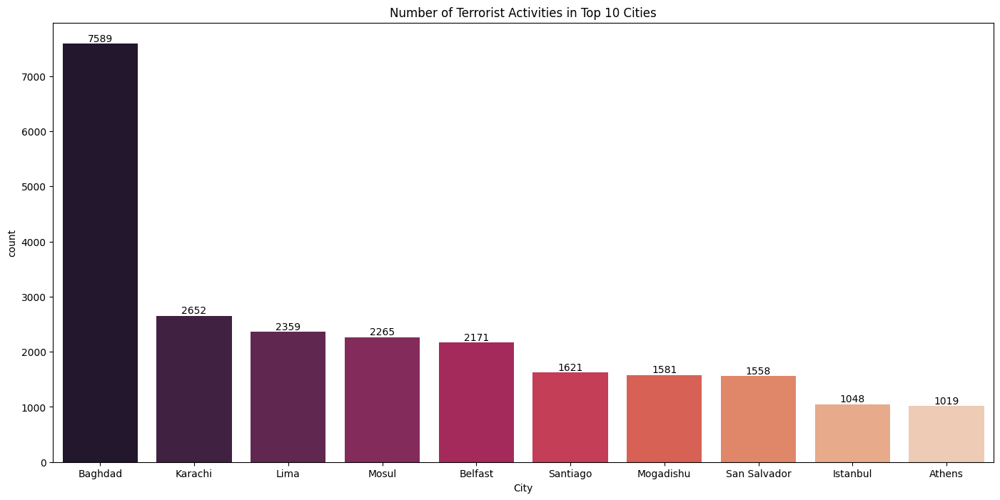

In [42]:
plt.figure(figsize=(17,8))
top_cities = df_terrorism['City'].value_counts().index[1:11]
ax = sns.countplot(x='City', data=df_terrorism, order=top_cities, palette='rocket')
ax.bar_label(ax.containers[0], label_type='edge')
plt.title('Number of Terrorist Activities in Top 10 Cities')

#### Q Frequency of sucide rate in attacks

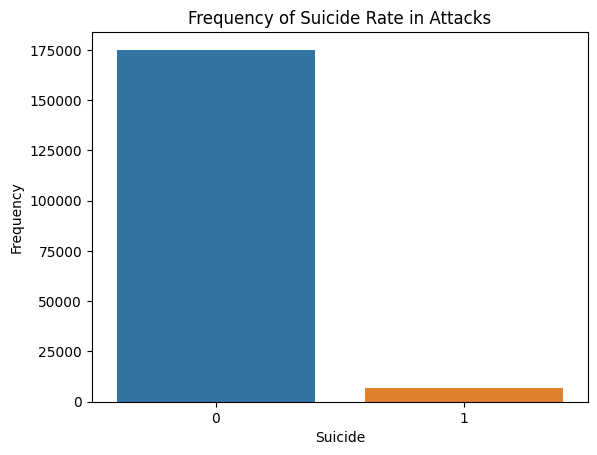

In [16]:
# Frequency of sucide rate in attacks

import seaborn as sns
import matplotlib.pyplot as plt

suicide_frequency = df_terrorism['Suicide'].value_counts()
sns.barplot(x=suicide_frequency.index, y=suicide_frequency.values)
plt.xlabel('Suicide')
plt.ylabel('Frequency')
plt.title('Frequency of Suicide Rate in Attacks')
plt.show()

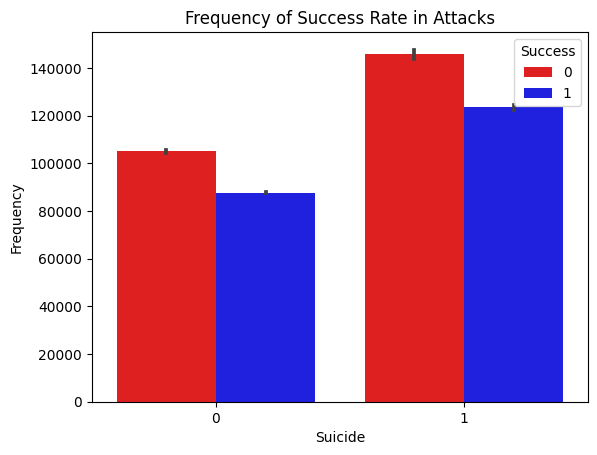

In [16]:
import seaborn as sns
import matplotlib.pyplot as plt

sns.barplot(data=df_terrorism, x='Suicide', y=df_terrorism.index, hue='Success',palette=['red', 'blue'])
plt.xlabel('Suicide')
plt.ylabel('Frequency')
plt.title('Frequency of Success Rate in Attacks')
plt.show()

### Q Visualize the No of terrorist activites through out the years

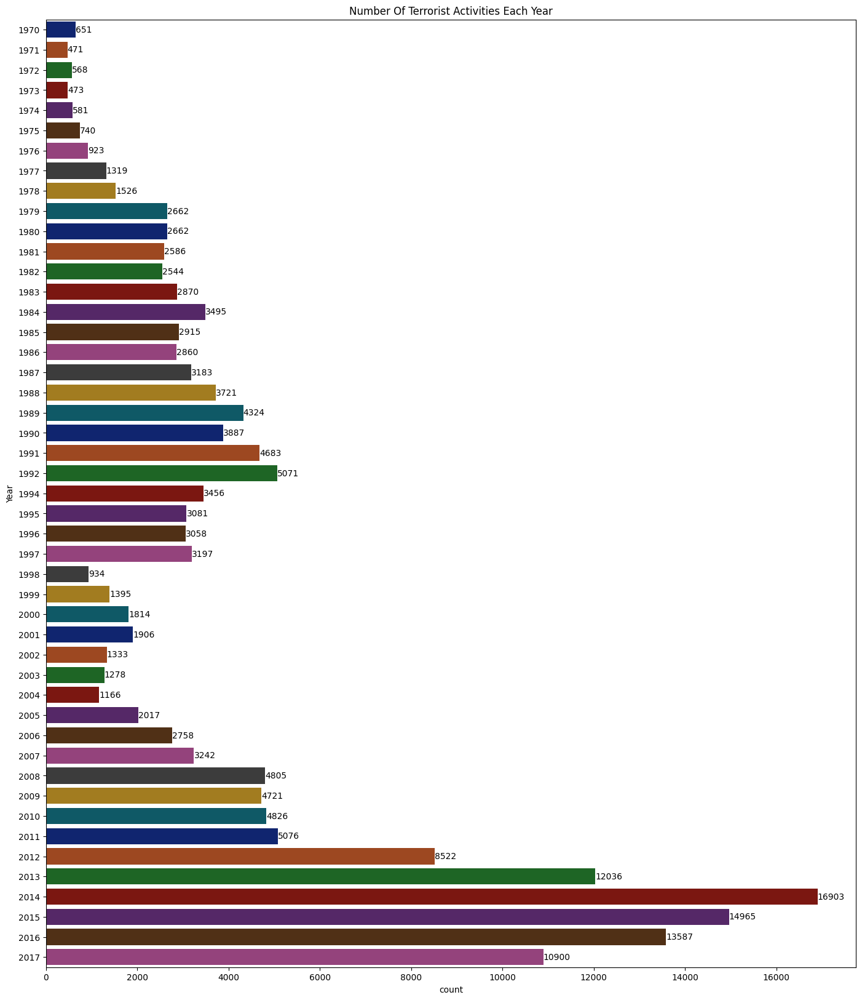

In [17]:
plt.figure(figsize=(17,20))
ax=sns.countplot(y=df_terrorism['Year'],palette='dark')
ax.bar_label(ax.containers[0],label_type='edge')
plt.title('Number Of Terrorist Activities Each Year');

**Observation**
- The terrorist attack peaked from **2012** with year **2014 as the highest number of terrorist attacks** followed by **2015 and 2016**

### Q Visualize the Number of terrorist activities in top 10 cities

Text(0.5, 1.0, 'Number of Terrorist Activities in Top 10 Cities')

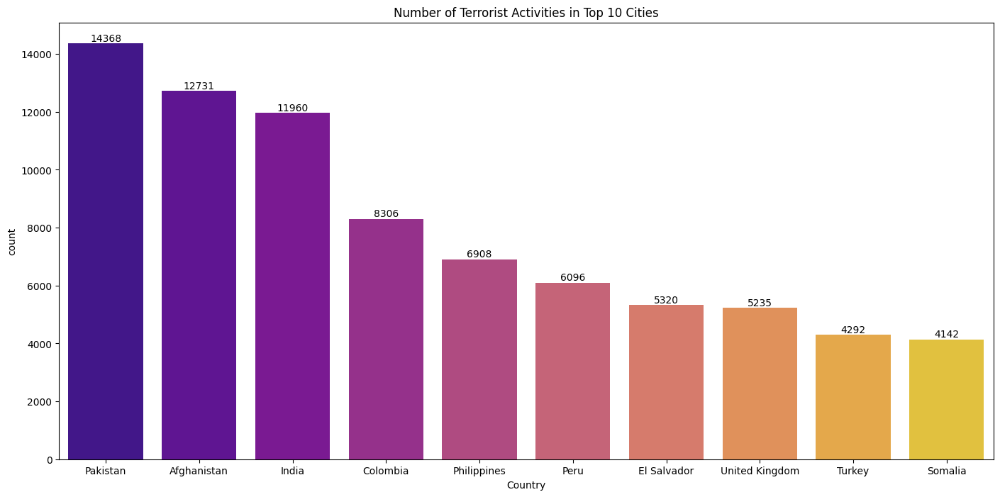

In [20]:
plt.figure(figsize=(17,8))
top_cities = df_terrorism['Country'].value_counts().index[1:11]
ax = sns.countplot(x='Country', data=df_terrorism, order=top_cities, palette='plasma')
ax.bar_label(ax.containers[0], label_type='edge')
plt.title('Number of Terrorist Activities in Top 10 Cities')

### Q Visualize the No of terrorist activities in top 10 region by year

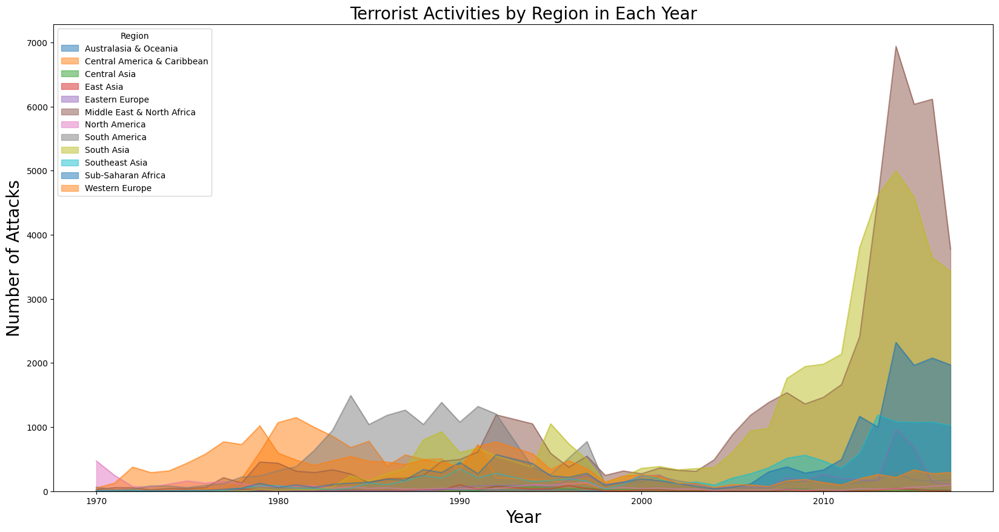

In [21]:
pd.crosstab(df_terrorism.Year,df_terrorism.Region).plot(kind='area',stacked=False,figsize=(20,10))
plt.title('Terrorist Activities by Region in Each Year',fontsize = 20)
plt.ylabel('Number of Attacks',fontsize = 20)
plt.xlabel('Year',fontsize = 20);

### Q Visualize the terrorist groups using a word cloud (The size of the word shows the repetitive attacks by a terrorist organization  )

Wordcloud imported!
word cloud dictionary created!



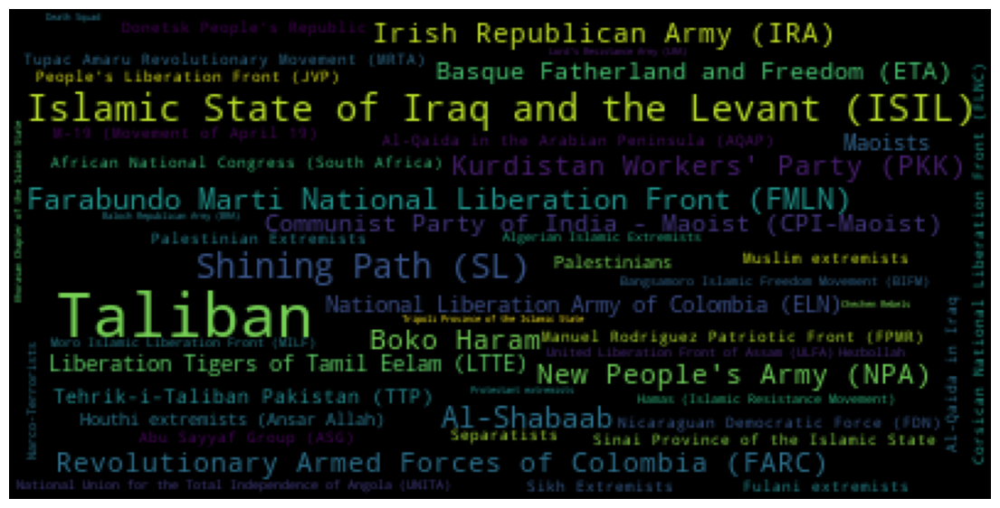

In [44]:
#import package and its set of stopwords
from collections import Counter
from wordcloud import WordCloud, STOPWORDS

print ('Wordcloud imported!')

text_list = df_terrorism['Attack_Group'].tolist()
word_could_dict=Counter(text_list)
word_could_dict.pop('Unknown')
print('word cloud dictionary created!\n')

wc = WordCloud()

# creating stopwords
stop_words = list(wc.stopwords)
custom_stop_words = ['Unknown']
stop_words = set(stop_words + custom_stop_words)

wc = WordCloud(stopwords=stop_words)

wc.generate_from_frequencies(word_could_dict)

fig = plt.figure(figsize=(14, 18))

# display the cloud
plt.imshow(wc)
plt.axis('off')
plt.show()

##### **Observation:** ISIL, FMLN, and Taliban are three most prominent organization in conducting terrorist activities

### Q  Visualize the top 10 common target types for terrorists

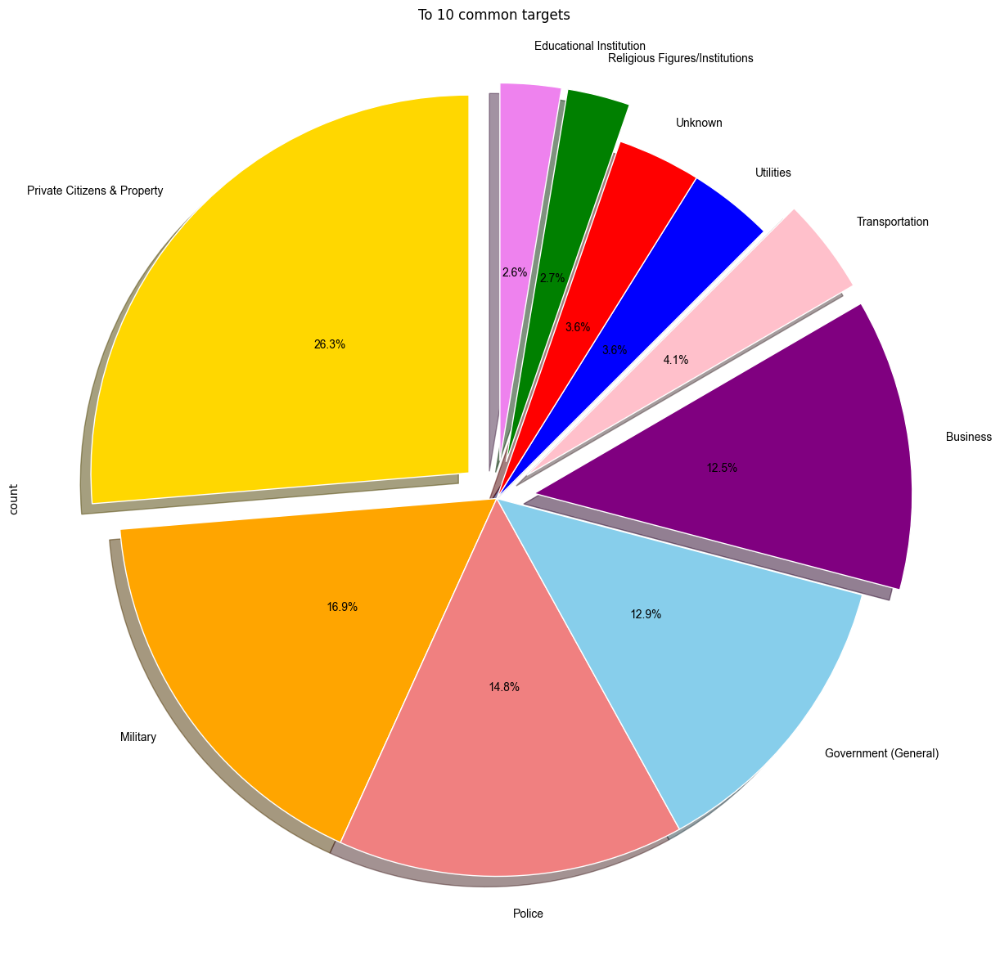

In [21]:
### type your answer here
colors_list = ['gold', 'orange', 'lightcoral', 'skyblue', 'purple', 'pink','blue','red','green','Violet']
# colors

explode_list = [0.1, 0, 0, 0, 0.1, 0.1,0, 0, 0.1, 0.1] # ratio for each continent with which to offset each wedge.

df_terrorism['Target_Type'].value_counts()[:10].plot(kind='pie',
                    figsize=(15, 15),
                    autopct='%1.1f%%',
                    startangle=90,
                    shadow=True,
                    pctdistance=0.5,
                    colors=colors_list,
                    explode=explode_list,
                    textprops={'fontname':'Arial'},
                    wedgeprops = { 'linewidth' : 1, 'edgecolor' : 'white' },
                    labels=df_terrorism['Target_Type'].value_counts()[:10].index
                    )

plt.title('To 10 common targets ')


plt.show()

### Q Visualize the No of Persons killed by Year In Pakistan. What is the relation?

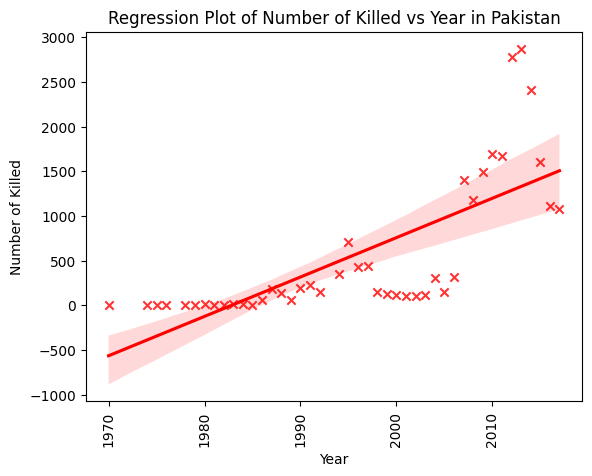

In [31]:
# reg plot for Number of killed vs year in Pakistan , ticklabels should be cross 'x', and number of killed of each should be summed up first
import seaborn as sns
import matplotlib.pyplot as plt

# Filter the data for Pakistan
df_pakistan = df_terrorism[df_terrorism['Country'] == 'Pakistan']

# Group the data by year and sum the number of killed
df_pakistan_grouped = df_pakistan.groupby('Year')['Number_of_Killed'].sum().reset_index()

# Create a regression plot 
sns.regplot(x='Year', y='Number_of_Killed', data=df_pakistan_grouped, marker='x',color='red')

# Set the ticklabels to cross 'x'
plt.xticks(rotation=90)


# Add labels and title
plt.xlabel('Year')
plt.ylabel('Number of Killed')
plt.title('Regression Plot of Number of Killed vs Year in Pakistan')

# Show the plot
plt.show()

### Q Visualize the Number of people killed by year and country wise

In [26]:
import plotly.express as px
fig = px.scatter(df_terrorism, y= 'Year',
            x = "Number_of_Killed",
            size= "Number_of_Killed", color= "Country",

            log_x=True, size_max=55, range_y=[1970,2020], range_x=[5,1500])

fig.show()

# chloreopath and world map

In [18]:
# download countries geojson file
! wget --quiet https://cf-courses-data.s3.us.cloud-object-storage.appdomain.cloud/IBMDeveloperSkillsNetwork-DV0101EN-SkillsNetwork/Data%20Files/world_countries.json

print('GeoJSON file downloaded!')

GeoJSON file downloaded!


'wget' is not recognized as an internal or external command,
operable program or batch file.


In [19]:
import folium
world_geo = r'https://cf-courses-data.s3.us.cloud-object-storage.appdomain.cloud/IBMDeveloperSkillsNetwork-DV0101EN-SkillsNetwork/Data%20Files/world_countries.json' # geojson file

# create a plain world map
world_map = folium.Map(location=[0, 0], zoom_start=2)

In [20]:
# generate choropleth map using the total immigration of each country to Canada from 1980 to 2013
world_map.choropleth(
    geo_data=world_geo,
    data=df_terrorism,
    columns=['Country', 'Number_of_Killed'],
    key_on='feature.properties.name',
    fill_color='YlOrRd',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Number of Killed'
)

# display map
world_map

c:\Python311\Lib\site-packages\folium\folium.py:465: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  warnings.warn(


In [15]:
import plotly.express as px
# Create the map visualization
fig = px.choropleth(df_terrorism, locations='Country',  locationmode='country names',color = 'Number_of_Killed',
                    title='No of person killed by Country', animation_frame='Year',animation_group="Country")
# Display the map
fig.show()
# locationmode='country names'

# Multivariate Analysis

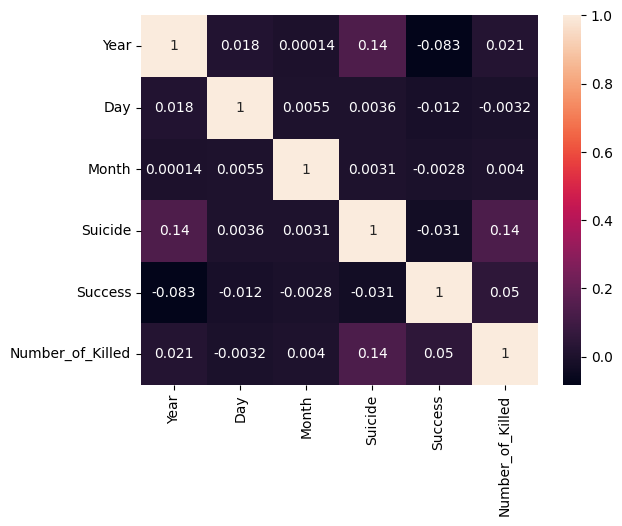

In [35]:
sns.heatmap(df_terrorism[['Year','Day','Month','Suicide','Success','Number_of_Killed']].corr(),annot=True)
plt.rcParams['figure.figsize']=(17,10);

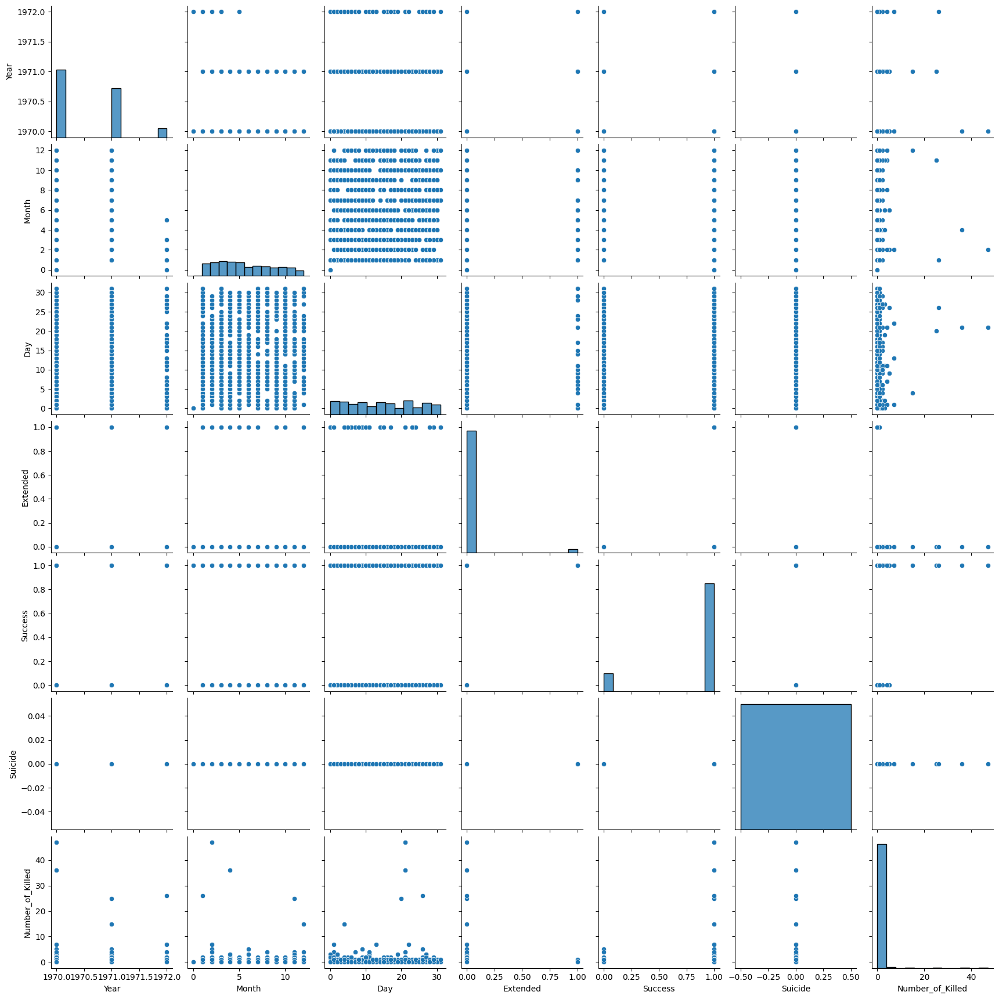

In [27]:
sns.pairplot(df_terrorism);